In [88]:
def rgb_equalized(image):
    # create a CLAHE object (Arguments are optional).
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    channels = cv2.split(image)
    
    eq_channels = []
    for ch, color in zip(channels, ['B', 'G', 'R']):
        eq_channels.append(clahe.apply(ch))

    eq_image = cv2.merge(eq_channels)
    eq_image = cv2.cvtColor(eq_image, cv2.COLOR_BGR2RGB)
    
    return eq_image

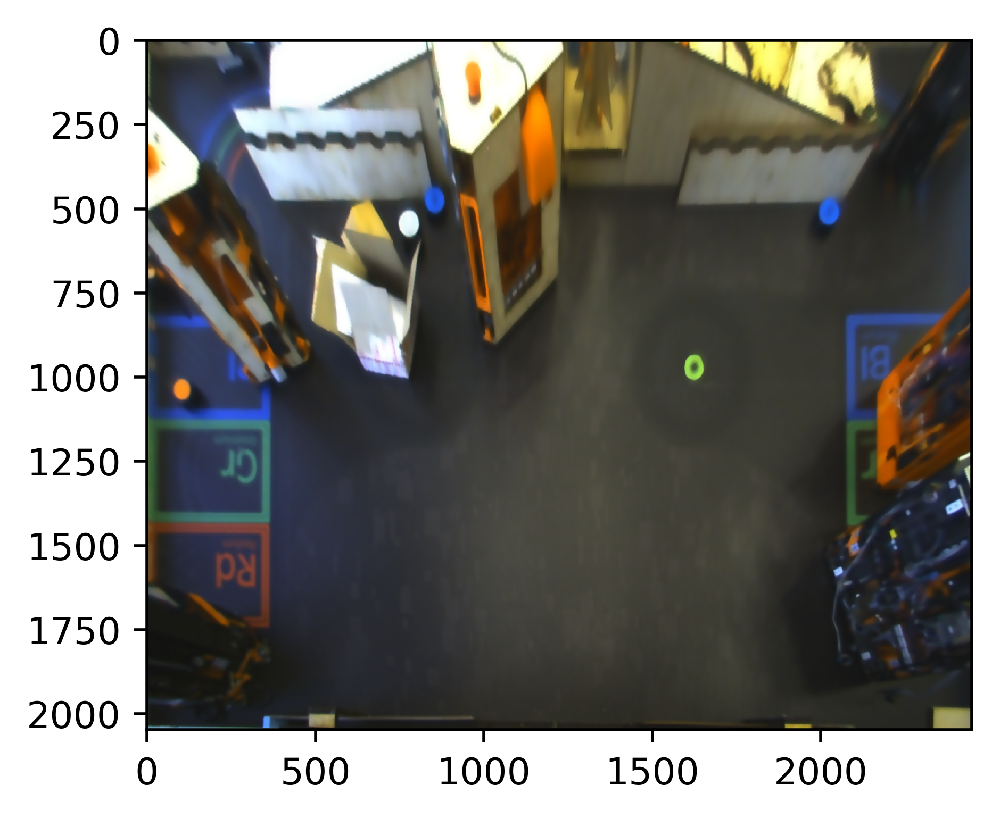

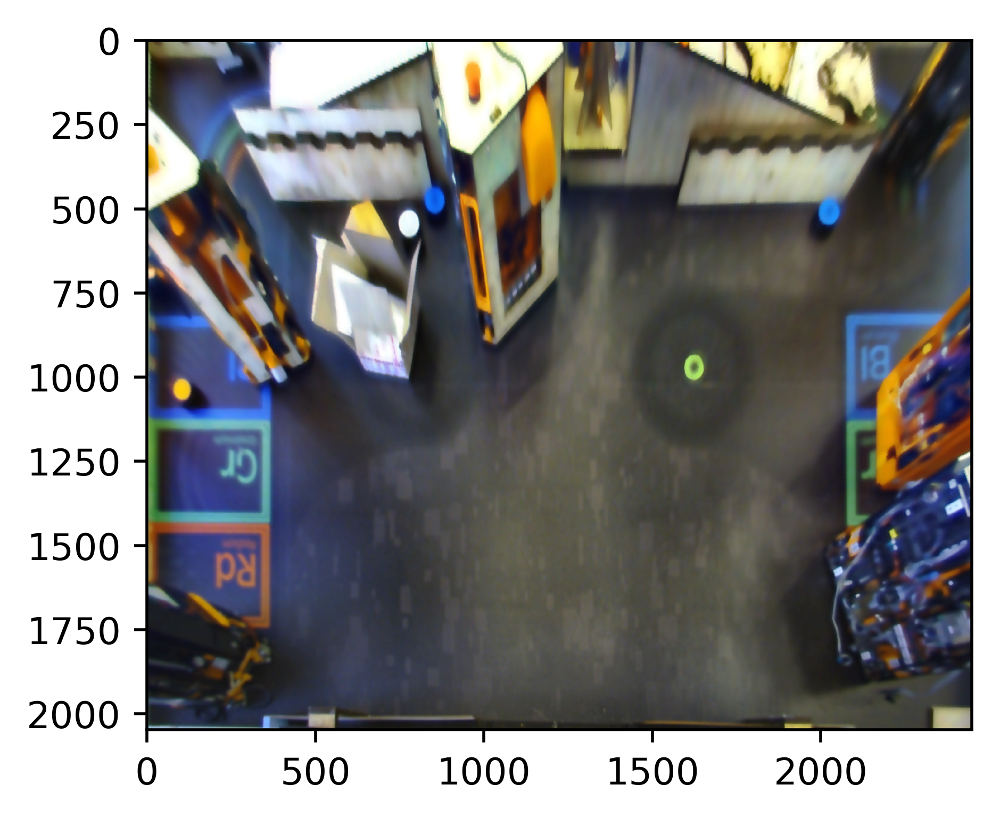

In [90]:
img = rgb_equalized(image)

rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(rgb_img)

fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(img)


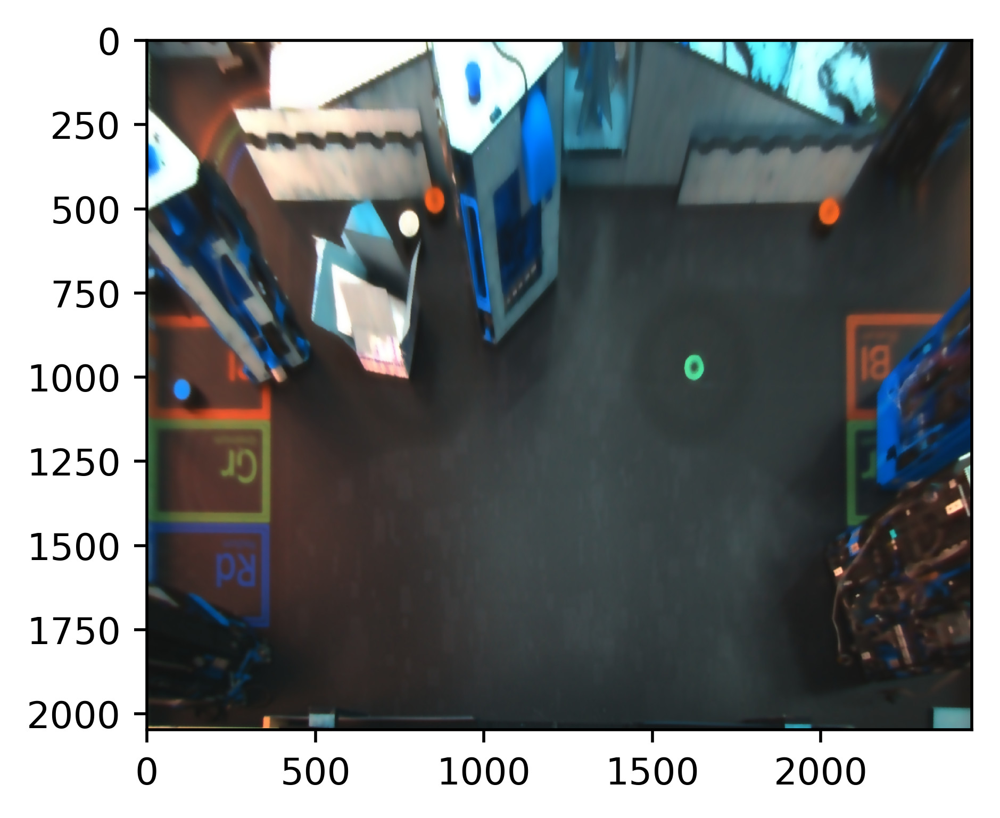

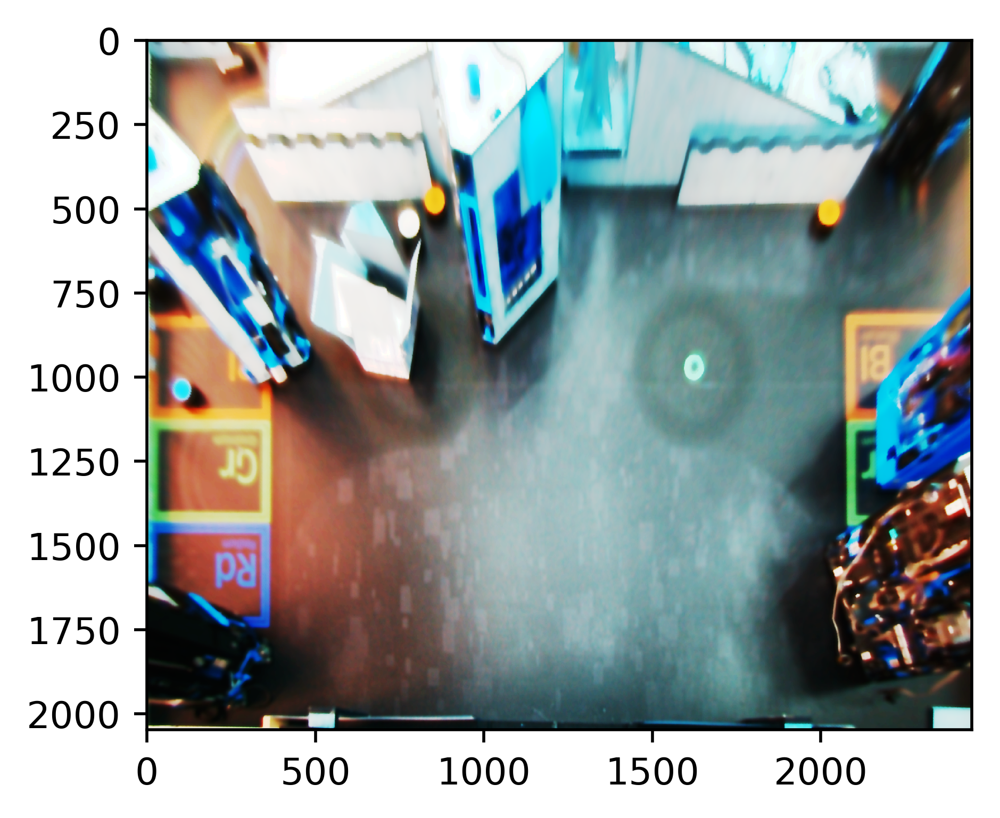

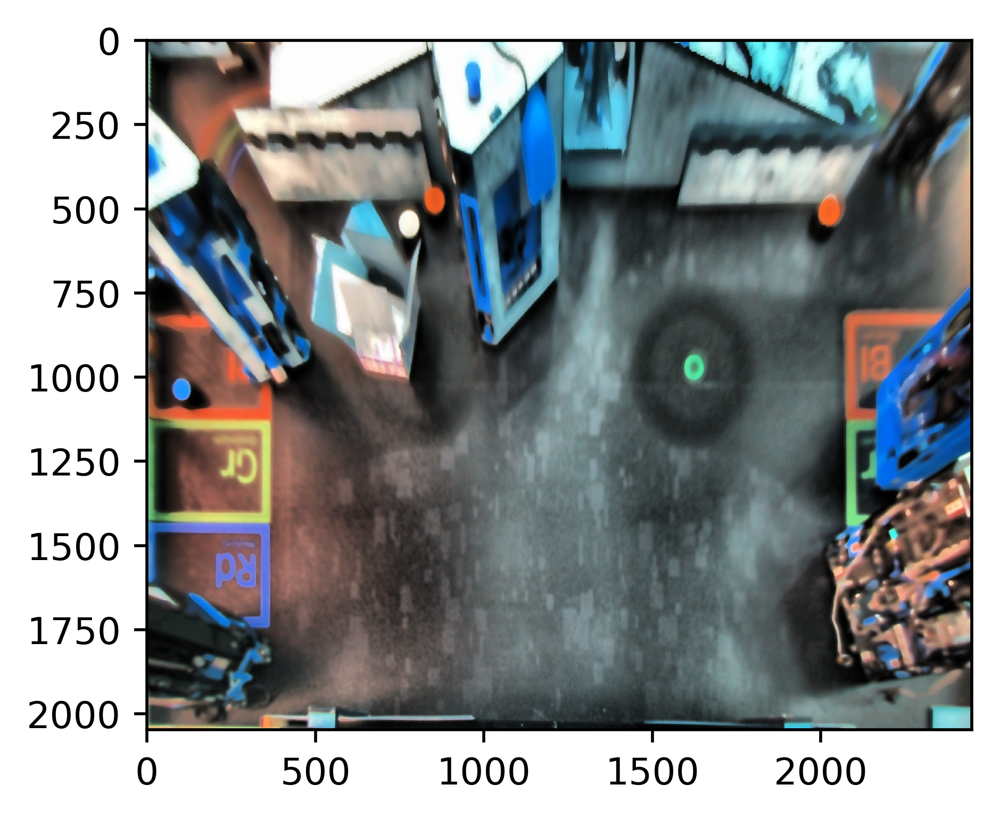

In [72]:
import numpy as np

import cv2
from skimage import exposure
from skimage import filters
import matplotlib.pyplot as plt


image = cv2.imread("/home/nuka-cola/.ros/camera_image.png")


# Equalization
img_eq = exposure.equalize_hist(image)

img_adapteq = exposure.equalize_adapthist(image, clip_limit=0.03)



fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(image)

fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(img_eq)


fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(img_adapteq)

# plt.imshow(img_adapteq)




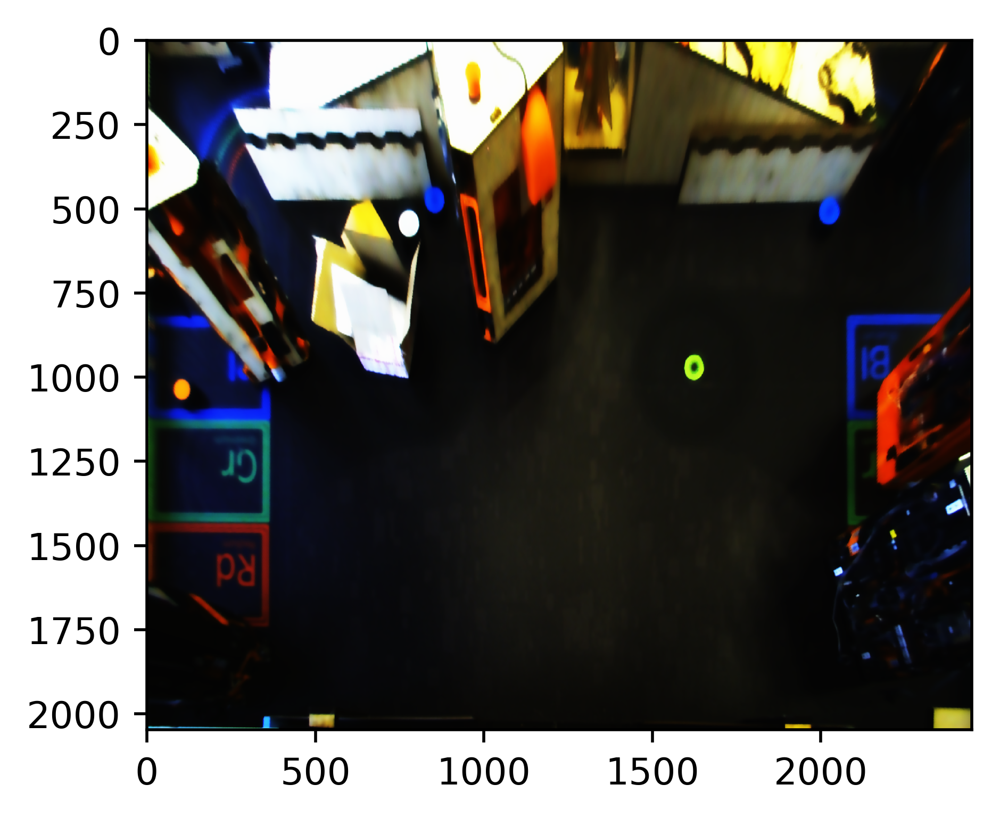

In [125]:
import skimage

contrans_image = skimage.exposure.adjust_sigmoid(rgb_img)


fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(contrans_image)

In [2]:
print (image)
image.astype(np.float64)
image = image/255.
print (image)

[[[ 0.27843137  0.29019608  0.21568627]
  [ 0.27843137  0.28627451  0.21568627]
  [ 0.2745098   0.28235294  0.21568627]
  ..., 
  [ 0.10980392  0.11764706  0.1254902 ]
  [ 0.10980392  0.12156863  0.1254902 ]
  [ 0.10980392  0.12156863  0.1254902 ]]

 [[ 0.27843137  0.29019608  0.21568627]
  [ 0.27843137  0.29019608  0.21568627]
  [ 0.27843137  0.28627451  0.21568627]
  ..., 
  [ 0.10980392  0.11764706  0.1254902 ]
  [ 0.10980392  0.12156863  0.1254902 ]
  [ 0.10980392  0.12156863  0.12941176]]

 [[ 0.28235294  0.29411765  0.21568627]
  [ 0.28235294  0.29019608  0.21568627]
  [ 0.27843137  0.29019608  0.21568627]
  ..., 
  [ 0.10980392  0.12156863  0.1254902 ]
  [ 0.10980392  0.12156863  0.12941176]
  [ 0.10980392  0.12156863  0.12941176]]

 ..., 
 [[ 0.45490196  0.62745098  0.95294118]
  [ 0.45490196  0.63137255  0.95294118]
  [ 0.45882353  0.63137255  0.95294118]
  ..., 
  [ 0.5372549   0.51764706  0.34509804]
  [ 0.53333333  0.51372549  0.34509804]
  [ 0.53333333  0.51372549  0.34117

In [3]:
from skimage.filters import laplace

c = 30

image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
sharpened_img_gray = image_gray + c*laplace(image_gray)                       
                          
fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(image_gray, cmap="gray")d 

fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(sharpened_img_gray,cmap="gray")

error: /tmp/binarydeb/ros-kinetic-opencv3-3.3.1/modules/imgproc/src/color.cpp:11073: error: (-215) depth == 0 || depth == 2 || depth == 5 in function cvtColor


In [ ]:
# Laplace filter

c = 0.2
image_laplace = filters.laplace(image)

sharpened_img = image - c*image_laplace

fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(sharpened_img.clip(0,1))

In [56]:
print ("image.dtype", image)
img_hist = img_adapteq*255
img_hist = img_hist.astype(np.uint8)
print ("image_hist", img_hist)

('image.dtype', array([[[ 71,  74,  55],
        [ 71,  73,  55],
        [ 70,  72,  55],
        ..., 
        [ 28,  30,  32],
        [ 28,  31,  32],
        [ 28,  31,  32]],

       [[ 71,  74,  55],
        [ 71,  74,  55],
        [ 71,  73,  55],
        ..., 
        [ 28,  30,  32],
        [ 28,  31,  32],
        [ 28,  31,  33]],

       [[ 72,  75,  55],
        [ 72,  74,  55],
        [ 71,  74,  55],
        ..., 
        [ 28,  31,  32],
        [ 28,  31,  33],
        [ 28,  31,  33]],

       ..., 
       [[116, 160, 243],
        [116, 161, 243],
        [117, 161, 243],
        ..., 
        [137, 132,  88],
        [136, 131,  88],
        [136, 131,  87]],

       [[115, 159, 245],
        [116, 159, 245],
        [117, 160, 245],
        ..., 
        [137, 132,  87],
        [136, 131,  87],
        [135, 130,  87]],

       [[115, 158, 247],
        [116, 158, 247],
        [116, 159, 247],
        ..., 
        [137, 131,  86],
        [136, 131,  86],
  

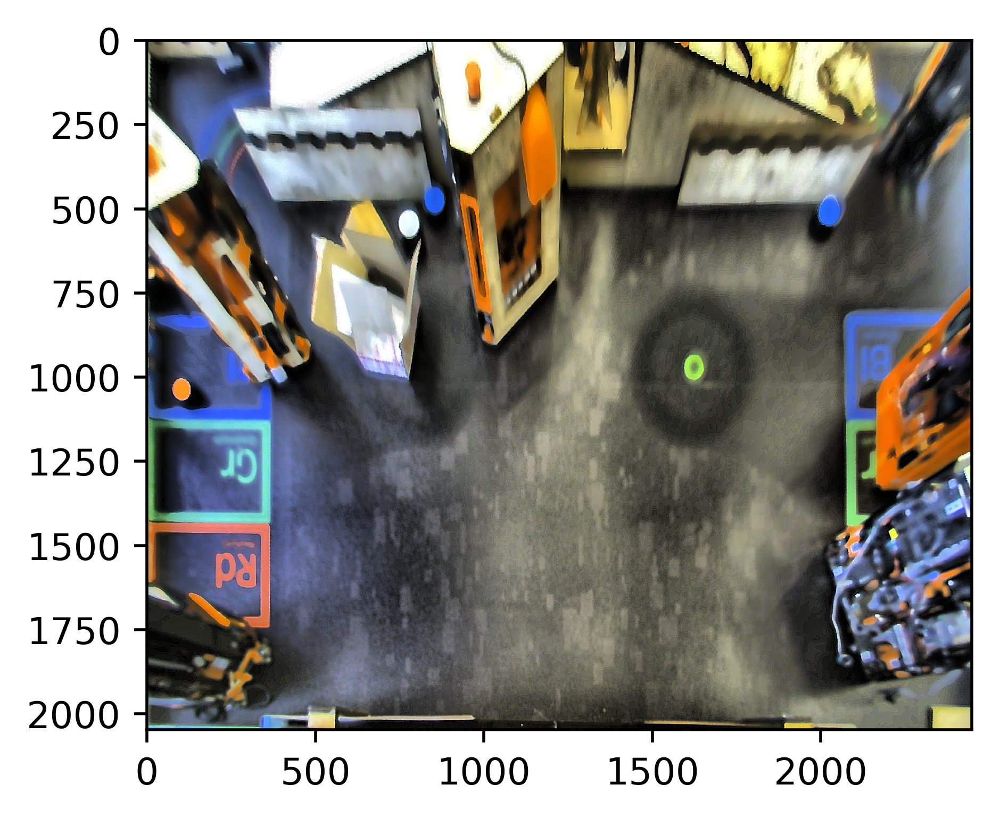

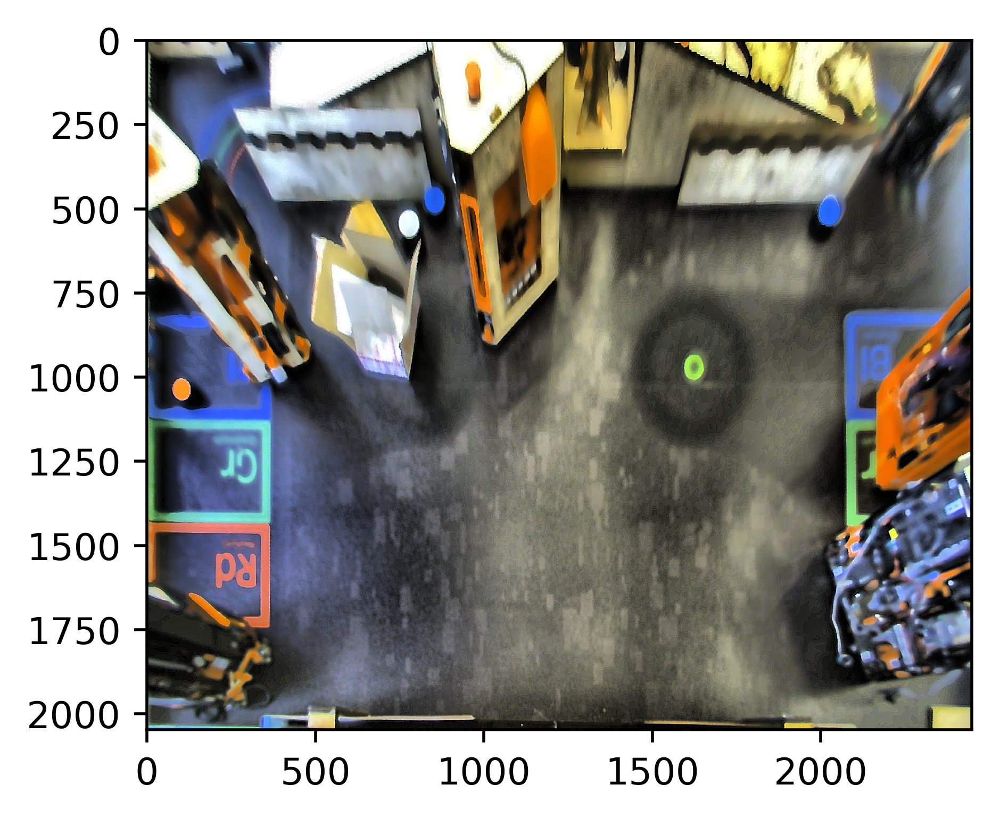

In [69]:
# [variables]
    # Declare the variables we are going to use
ddepth = cv2.CV_16S
kernel_size = 3

# Remove noise by blurring with a Gaussian filter

#src = cv.GaussianBlur(src, (3, 3), 0)v
# [reduce_noise]
# [convert_to_gray]
# Convert the image to grayscale

img_adapteq_gray = cv2.cvtColor(img_hist, cv2.COLOR_RGB2GRAY)
# [convert_to_gray]
# Create Window

# [laplacian]
# Apply Laplace function
gaussian_3 = cv2.GaussianBlur(img_hist,(9,9), 100.0)
dst = cv2.Laplacian(img_adapteq_gray, ddepth, kernel_size)

unsharp_image = cv2.addWeighted(img_hist, 1.5, gaussian_3, -0.5, 0, img_hist)

# [laplacian]
# [convert]
# converting back to uint8
abs_dst = cv2.convertScaleAbs(dst)
# [convert]
# [display]

fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(img_hist)

fig, ax = plt.subplots(1,1,figsize=(4,4), dpi=500)
plt.imshow(unsharp_image)
